<a href="https://colab.research.google.com/github/Liorinio/Who-s_that_animal/blob/main/Who's_That_Animal_Model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Imports and installation

In [ ]:
!pip install torchvision timm
!pip install opencv-python
!pip install cv2
!pip install torch-xla

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 1.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.5/2.5 MB 56.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.0/67.0 MB 20.7 MB/s eta 0:00:00
ERROR: Could not find a version that satisfies the requirement cv2 (from versions: none)
ERROR: No matching distribution found for cv2


In [ ]:
from google.colab import drive
from PIL import Image, ImageOps
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
from pathlib import Path
from tqdm import tqdm
import os
import concurrent.futures
import plotly.express as px
from sklearn.model_selection import train_test_split
import cv2
import random

import torch
import torch.nn as nn
from torchvision import transforms, datasets
from torch.utils.data import DataLoader, random_split, Dataset
from sklearn.metrics import classification_report
import timm
import torch.optim as optim
from sklearn.preprocessing import LabelEncoder
import torch_xla
import torch_xla.core.xla_model as xm
from torchvision import models
import joblib
from collections import Counter
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import json
from torch.optim.lr_scheduler import StepLR

/usr/local/lib/python3.12/dist-packages/torch_xla/experimental/gru.py:113: SyntaxWarning: invalid escape sequence '\_'
  * **h_n**: tensor of shape :math:`(D * \text{num\_layers}, H_{out})` or


# Data visualization

In [ ]:
def process_image(img_path, label):
  try:
     with Image.open(img_path) as img:
       # Convert to RGB to avoid issues with images in different modes (e.g. RGBA, L)
        img = img.convert("RGB") # Resize while keeping aspect ratio and add padding to make it exactly 256x256
        img.thumbnail((256, 256), Image.Resampling.LANCZOS) # Use modern resampling method
        delta_w = 256 - img.width
        delta_h = 256 - img.height
        padding = ( delta_w // 2, delta_h // 2, delta_w - (delta_w // 2), delta_h - (delta_h // 2) )
        padded_img = ImageOps.expand(img, padding, fill=(0, 0, 0)) # Black padding
         # Overwrite the image
        padded_img.save(img_path)
        return {'image_path': img_path, 'label': label}

  except Exception as e:
      print(f"Error loading or resizing image {img_path}: {e}")
      return None

In [ ]:
def load_images_to_dataframe(main_folder_path):
    # Ensure this function only runs in Google Colab
    if 'google.colab' in str(get_ipython()):
        drive.mount('/content/drive', force_remount=True)

    data = []

    # Use a ThreadPoolExecutor to parallelize the processing of images
    with concurrent.futures.ThreadPoolExecutor() as executor:
        futures = []
        for label in os.listdir(main_folder_path):
            label_path = os.path.join(main_folder_path, label)
            if os.path.isdir(label_path):
                for filename in os.listdir(label_path):
                    if filename.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp')):
                        img_path = os.path.join(label_path, filename)
                        futures.append(executor.submit(process_image, img_path, label))

        for future in concurrent.futures.as_completed(futures):
            result = future.result()
            if result:
                data.append(result)

    return pd.DataFrame(data)

In [ ]:
main_folder_path = "/content/drive/MyDrive/Who's_That_Animal?/animals"
df = load_images_to_dataframe(main_folder_path)
print(df.head())

Mounted at /content/drive
                                          image_path     label
0  /content/drive/MyDrive/Who's_That_Animal?/anim...    turtle
1  /content/drive/MyDrive/Who's_That_Animal?/anim...    wombat
2  /content/drive/MyDrive/Who's_That_Animal?/anim...  squirrel
3  /content/drive/MyDrive/Who's_That_Animal?/anim...     snake
4  /content/drive/MyDrive/Who's_That_Animal?/anim...    turkey


In [ ]:
df.describe()

,image_path,label
count,5700,5700
unique,5700,95
top,/content/drive/MyDrive/Who's_That_Animal?/anim...,turtle
freq,1,60


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5700 entries, 0 to 5699
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   image_path  5700 non-null   object
 1   label       5700 non-null   object
dtypes: object(2)
memory usage: 89.2+ KB


In [ ]:
df.isnull().sum()

,0
image_path,0
label,0


In [ ]:
df = df.sort_values(by='label', ascending=True).reset_index(drop=True)
df.head()

,image_path,label
0,/content/drive/MyDrive/Who's_That_Animal?/anim...,antelope
1,/content/drive/MyDrive/Who's_That_Animal?/anim...,antelope
2,/content/drive/MyDrive/Who's_That_Animal?/anim...,antelope
3,/content/drive/MyDrive/Who's_That_Animal?/anim...,antelope
4,/content/drive/MyDrive/Who's_That_Animal?/anim...,antelope


In [ ]:
def get_image_shape(df, index):
    # Get the image path from the DataFrame at the given index
    img_path = df['image_path'].iloc[index]

    # Open the image using PIL
    with Image.open(img_path) as img:
        # Convert the image to a numpy array to get the shape
        img_array = np.array(img)

    # Return the shape of the image
    return img_array.shape

for i in range(1, df.shape[0], 500):
  print(get_image_shape(df, i))

(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


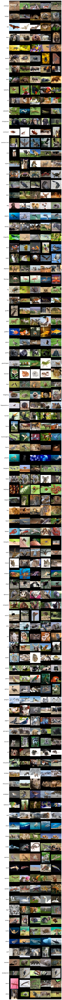

In [ ]:
# Get all unique categories
all_categories = df["label"].unique()

# Filter dataset to include all images
filtered_df = df[df["label"].isin(all_categories)]

# Number of images per category
num_samples_per_category = 5  # Adjust if needed
image_grid = []
labels_list = []

for category in all_categories:
    category_images = df[df["label"] == category]["image_path"].values

    # Ensure unique random selection of images
    if len(category_images) >= num_samples_per_category:
        selected_images = random.sample(list(category_images), num_samples_per_category)
    else:
        selected_images = category_images  # If fewer images exist, take all available

    row_images = []

    for image_path in selected_images:
        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        # Resize images to a fixed width and height while maintaining aspect ratio.
        image = cv2.resize(image, (256, 256))  # Resize to a fixed size
        row_images.append(image)

    # Stack images horizontally to create a row
    image_grid.append(np.hstack(row_images))
    labels_list.append(category)  # Save label for this row

# Stack all rows vertically to form the final grid
final_image = np.vstack(image_grid)

# Display the image grid with labels
fig, ax = plt.subplots(figsize=(30, len(all_categories) * 2))  # Adjust height dynamically
ax.imshow(final_image)
ax.axis("off")

# Add labels on the left side
for i, label in enumerate(labels_list):
   ax.text(
        -10,  # X position (negative to shift left)
        (i + 0.5) * final_image.shape[0] / len(labels_list),  # Center text in the row
        label,
        fontsize=12,
        color="black",
        weight="normal",
        ha="right",  # Align to the right
        va="center",  # Center vertically
    )

plt.show()

In [ ]:
labels = []
counts = []
label_counts = df.iloc[:, 1].value_counts()
for label, count in label_counts.items():
  labels.append(label)
  counts.append(count)
df_counts = pd.DataFrame({'label': labels, 'count': counts})
df_counts = df_counts.sort_values(by='label', ascending=True).reset_index(drop=True)
df_counts.head()

,label,count
0,antelope,60
1,badger,60
2,bat,60
3,bear,60
4,bee,60


In [ ]:
fig = px.bar(df_counts,
             x='label',
             y='count',
             title='Distribution of Animal Classes',
             color='label', # <-- Set color to 'label' to color bars by animal class.
             color_continuous_scale='Viridis',
             template='plotly_dark')
fig.update_layout(title_font_size=24, title_x=0.5, xaxis_title_font_size=18, yaxis_title_font_size=18, font=dict(family="Arial, sans-serif", size=14))
fig.show()

In [ ]:
label_list = []
for i in range(0, df.shape[0], 60):
    label_list.append(df.loc[i, "label"])
label_dict = {item: index for index, item in enumerate(label_list)}
print(label_dict)

{'antelope': 0, 'badger': 1, 'bat': 2, 'bear': 3, 'bee': 4, 'beetle': 5, 'bison': 6, 'boar': 7, 'butterfly': 8, 'cat': 9, 'caterpillar': 10, 'chimpanzee': 11, 'cockroach': 12, 'common loon': 13, 'cow': 14, 'coyote': 15, 'crab': 16, 'crow': 17, 'deer': 18, 'dog': 19, 'dolphin': 20, 'donkey': 21, 'dragonfly': 22, 'duck': 23, 'eagle': 24, 'elephant': 25, 'flamingo': 26, 'fly': 27, 'fox': 28, 'giraffe': 29, 'goat': 30, 'goldfish': 31, 'goose': 32, 'gorilla': 33, 'grasshopper': 34, 'hamster': 35, 'hare': 36, 'hedgehog': 37, 'hippopotamus': 38, 'hornbill': 39, 'horse': 40, 'hummingbird': 41, 'hyena': 42, 'jellyfish': 43, 'kangaroo': 44, 'koala': 45, 'ladybugs': 46, 'leopard': 47, 'lion': 48, 'lizard': 49, 'lobster': 50, 'mosquito': 51, 'moth': 52, 'mouse': 53, 'octopus': 54, 'okapi': 55, 'opossum': 56, 'orangutan': 57, 'ostrich': 58, 'otter': 59, 'owl': 60, 'ox': 61, 'oyster': 62, 'panda': 63, 'parrot': 64, 'pelican': 65, 'penguin': 66, 'pig': 67, 'pigeon': 68, 'porcupine': 69, 'raccoon': 70

In [ ]:
df.replace({"label": label_dict}, inplace=True)
for i in range(0, df.shape[0], 60):
  print(df.loc[i])

image_path    /content/drive/MyDrive/Who's_That_Animal?/anim...
label                                                         0
Name: 0, dtype: object
image_path    /content/drive/MyDrive/Who's_That_Animal?/anim...
label                                                         1
Name: 60, dtype: object
image_path    /content/drive/MyDrive/Who's_That_Animal?/anim...
label                                                         2
Name: 120, dtype: object
image_path    /content/drive/MyDrive/Who's_That_Animal?/anim...
label                                                         3
Name: 180, dtype: object
image_path    /content/drive/MyDrive/Who's_That_Animal?/anim...
label                                                         4
Name: 240, dtype: object
image_path    /content/drive/MyDrive/Who's_That_Animal?/anim...
label                                                         5
Name: 300, dtype: object
image_path    /content/drive/MyDrive/Who's_That_Animal?/anim...
label                

/tmp/ipython-input-1260379004.py:1: FutureWarning:

Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`



In [ ]:
# Create the directory if it doesn't exist
os.makedirs("/content/drive/MyDrive/Who's_That_Animal?/LabelDict", exist_ok=True)

# Save to file
with open("/content/drive/MyDrive/Who's_That_Animal?/LabelDict/LabelDict.json", 'w') as f:
    json.dump(label_dict, f)

In [ ]:
with open("/content/drive/MyDrive/Who's_That_Animal?/LabelDict/LabelDict.json", 'r') as f:
    loaded_dict = json.load(f)

print(loaded_dict)

{'antelope': 0, 'badger': 1, 'bat': 2, 'bear': 3, 'bee': 4, 'beetle': 5, 'bison': 6, 'boar': 7, 'butterfly': 8, 'cat': 9, 'caterpillar': 10, 'chimpanzee': 11, 'cockroach': 12, 'common loon': 13, 'cow': 14, 'coyote': 15, 'crab': 16, 'crow': 17, 'deer': 18, 'dog': 19, 'dolphin': 20, 'donkey': 21, 'dragonfly': 22, 'duck': 23, 'eagle': 24, 'elephant': 25, 'flamingo': 26, 'fly': 27, 'fox': 28, 'giraffe': 29, 'goat': 30, 'goldfish': 31, 'goose': 32, 'gorilla': 33, 'grasshopper': 34, 'hamster': 35, 'hare': 36, 'hedgehog': 37, 'hippopotamus': 38, 'hornbill': 39, 'horse': 40, 'hummingbird': 41, 'hyena': 42, 'jellyfish': 43, 'kangaroo': 44, 'koala': 45, 'ladybugs': 46, 'leopard': 47, 'lion': 48, 'lizard': 49, 'lobster': 50, 'mosquito': 51, 'moth': 52, 'mouse': 53, 'octopus': 54, 'okapi': 55, 'opossum': 56, 'orangutan': 57, 'ostrich': 58, 'otter': 59, 'owl': 60, 'ox': 61, 'oyster': 62, 'panda': 63, 'parrot': 64, 'pelican': 65, 'penguin': 66, 'pig': 67, 'pigeon': 68, 'porcupine': 69, 'raccoon': 70

In [ ]:
df['label'] = df['label'].astype(str)
train, test = train_test_split(df, test_size=0.2, random_state=42, stratify=df['label'])

X_train, y_train = train["image_path"].values, train["label"].values
X_test, y_test = test["image_path"].values, test["label"].values

In [ ]:
def print_image_info(dataset, num_samples):
    num_samples = min(num_samples, len(dataset)) # Ensure num_samples is within bounds
    # Sample and print information for each image in the dataset
    for i in range(num_samples):
        image_path = dataset[i]  # Access image path from the NumPy array
        image = plt.imread(image_path) # Read image using matplotlib.pyplot
        # Get the shape of the image
        shape = image.shape
        # Get the image mode
        image_mode = 'RGB' if shape[-1] == 3 else 'Grayscale'
        # Print the information
        print(f"Image Shape: {shape} \nImage Mode: {image_mode}\n")

In [ ]:
print_image_info(X_train, 5)

Image Shape: (256, 256, 3) 
Image Mode: RGB

Image Shape: (256, 256, 3) 
Image Mode: RGB

Image Shape: (256, 256, 3) 
Image Mode: RGB

Image Shape: (256, 256, 3) 
Image Mode: RGB

Image Shape: (256, 256, 3) 
Image Mode: RGB



# Model 1

In [ ]:
# ✅ Detect TPU or GPU/CPU
device = (torch_xla.core.xla_model.xla_device() if 'COLAB_TPU_ADDR' in os.environ else
          torch.device('cuda' if torch.cuda.is_available() else 'cpu'))

# ✅ Define Custom Classifier with 512 input features (from ResNet18) and 95 output classes
class CustomClassifier(nn.Module):
    def __init__(self, in_features, num_classes):
        super(CustomClassifier, self).__init__()
        self.classifier = nn.Sequential(
            nn.Linear(in_features, 512),
            nn.BatchNorm1d(512),
            nn.ReLU(),
            nn.Dropout(0.4),

            nn.Linear(512, 256),
            nn.BatchNorm1d(256),
            nn.ReLU(),
            nn.Dropout(0.3),

            nn.Linear(256, num_classes)
        )

    def forward(self, x):
        # x shape is (batch_size, 512, 7, 7)
        x = nn.functional.adaptive_avg_pool2d(x, (1, 1))  # Shape: (batch, 512, 1, 1)
        x = x.view(x.size(0), -1)  # Flatten to (batch, 512)
        return self.classifier(x)

# ✅ Define Custom Dataset
class CustomDataset(Dataset):
    def __init__(self, image_paths, labels, transform=None):
        self.image_paths = image_paths
        self.labels = labels
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image = Image.open(self.image_paths[idx]).convert("RGB")
        label = self.labels[idx]
        if self.transform:
            image = self.transform(image)
        return image, label

# ✅ Data Transforms
train_transform = transforms.Compose([
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(15),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2),
    transforms.Resize((224, 224)),
    transforms.ToTensor()
])

evaluation_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor()
])

In [ ]:
# ✅ Encode Labels
label_encoder = LabelEncoder()
all_labels = y_train.tolist() + y_test.tolist()
label_encoder.fit(all_labels)

y_train_encoded = label_encoder.transform(y_train)
y_test_encoded = label_encoder.transform(y_test)

y_train_tensor = torch.tensor(y_train_encoded, dtype=torch.long)
y_test_tensor = torch.tensor(y_test_encoded, dtype=torch.long)

# ✅ DataLoaders
train_dataset = CustomDataset(X_train, y_train_tensor, transform=train_transform)
test_dataset = CustomDataset(X_test, y_test_tensor, transform=evaluation_transform)
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

# ✅ Load Pretrained ResNet18 (exclude final FC layer)
backbone = models.resnet18(pretrained=True)

# ✅ Remove the final fully connected layer
modules = list(backbone.children())[:-2]  # Keep up to the last conv layer
feature_extractor = nn.Sequential(*modules)

# ✅ Freeze the backbone
for param in feature_extractor.parameters():
    param.requires_grad = False

# ✅ Create Combined Model: Feature Extractor + Custom Classifier
class CombinedModel(nn.Module):
    def __init__(self, feature_extractor, custom_classifier):
        super(CombinedModel, self).__init__()
        self.feature_extractor = feature_extractor
        self.custom_classifier = custom_classifier

    def forward(self, x):
        x = self.feature_extractor(x)
        x = self.custom_classifier(x)
        return x

# ✅ Instantiate new custom classifier and combined model
num_classes = len(label_encoder.classes_)
in_features = 512  # ResNet18 output channels before FC
custom_classifier = CustomClassifier(in_features=in_features, num_classes=num_classes)
model = CombinedModel(feature_extractor, custom_classifier)

# ✅ Move to device
model.to(device)

criterion = nn.CrossEntropyLoss()

# ✅ Optimizer on custom classifier parameters only
optimizer = optim.Adam(model.custom_classifier.parameters(), lr=0.001, weight_decay=1e-4)

# ✅ Add learning rate scheduler
scheduler = StepLR(optimizer, step_size=5, gamma=0.1)

# ✅ Trackers
train_loss_history, train_acc_history = [], []
test_loss_history, test_acc_history = [], []

/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:208: UserWarning:

The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.

/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:223: UserWarning:

Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.



Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth


100%|██████████| 44.7M/44.7M [00:00<00:00, 386MB/s]


In [ ]:
# Create the directory if it doesn't exist
os.makedirs("/content/drive/MyDrive/Who's_That_Animal?/LabelEncoder", exist_ok=True)

# Save the label_encoder object to a file
joblib.dump(label_encoder, "/content/drive/MyDrive/Who's_That_Animal?/LabelEncoder/labelencoder.pkl")

# Now, you can load it using:
label_encoder = joblib.load("/content/drive/MyDrive/Who's_That_Animal?/LabelEncoder/labelencoder.pkl")
class_names = list(label_encoder.classes_)
print(class_names)

[np.str_('0'), np.str_('1'), np.str_('10'), np.str_('11'), np.str_('12'), np.str_('13'), np.str_('14'), np.str_('15'), np.str_('16'), np.str_('17'), np.str_('18'), np.str_('19'), np.str_('2'), np.str_('20'), np.str_('21'), np.str_('22'), np.str_('23'), np.str_('24'), np.str_('25'), np.str_('26'), np.str_('27'), np.str_('28'), np.str_('29'), np.str_('3'), np.str_('30'), np.str_('31'), np.str_('32'), np.str_('33'), np.str_('34'), np.str_('35'), np.str_('36'), np.str_('37'), np.str_('38'), np.str_('39'), np.str_('4'), np.str_('40'), np.str_('41'), np.str_('42'), np.str_('43'), np.str_('44'), np.str_('45'), np.str_('46'), np.str_('47'), np.str_('48'), np.str_('49'), np.str_('5'), np.str_('50'), np.str_('51'), np.str_('52'), np.str_('53'), np.str_('54'), np.str_('55'), np.str_('56'), np.str_('57'), np.str_('58'), np.str_('59'), np.str_('6'), np.str_('60'), np.str_('61'), np.str_('62'), np.str_('63'), np.str_('64'), np.str_('65'), np.str_('66'), np.str_('67'), np.str_('68'), np.str_('69'), n

In [ ]:
os.makedirs("/content/drive/MyDrive/Who's_That_Animal?/SavedSecondModel", exist_ok=True)

In [ ]:
# ✅ Initialize best values
best_train_loss = float('inf')
best_test_loss = float('inf')
best_train_acc = 0.0
best_test_acc = 0.0

# ✅ Training + Evaluation Loop with Best Model Saving
num_epochs = 15
save_path = "/content/drive/MyDrive/Who's_That_Animal?/SavedSecondModel/savedSecondModelProjectAnimals.pth"

for epoch in range(num_epochs):
    # ---------- Training ----------
    model.train()
    running_loss, correct, total = 0.0, 0, 0

    for images, labels in tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs} - Training"):
        images, labels = images.to(device), labels.to(device)
        optimizer.zero_grad()

        outputs = model(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()
        _, predicted = torch.max(outputs, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

    train_loss = running_loss / len(train_loader)
    train_acc = 100 * correct / total
    train_loss_history.append(train_loss)
    train_acc_history.append(train_acc)

    print(f"Epoch [{epoch+1}/{num_epochs}], Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.2f}%")

    # ✅ Save if best train loss
    if train_loss < best_train_loss:
        best_train_loss = train_loss
        torch.save(model.state_dict(), save_path)
        print("✅ Saved model (best train loss)")

    # ✅ Save if best train accuracy
    if train_acc > best_train_acc:
        best_train_acc = train_acc
        torch.save(model.state_dict(), save_path)
        print("✅ Saved model (best train acc)")

    # ---------- Evaluation ----------
    model.eval()
    test_loss, correct, total = 0.0, 0, 0

    with torch.no_grad():
        for images, labels in tqdm(test_loader, desc=f"Epoch {epoch+1}/{num_epochs} - Testing"):
            images, labels = images.to(device), labels.to(device)

            outputs = model(images)
            loss = criterion(outputs, labels)

            test_loss += loss.item()
            _, predicted = torch.max(outputs, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

    test_loss /= len(test_loader)
    test_acc = 100 * correct / total
    test_loss_history.append(test_loss)
    test_acc_history.append(test_acc)

    print(f"Epoch [{epoch+1}/{num_epochs}], Test Loss: {test_loss:.4f}, Test Acc: {test_acc:.2f}%")

    # ✅ Save if best test loss
    if test_loss < best_test_loss:
        best_test_loss = test_loss
        torch.save(model.state_dict(), save_path)
        print("✅ Saved model (best test loss)")

    # ✅ Save if best test accuracy
    if test_acc > best_test_acc:
        best_test_acc = test_acc
        torch.save(model.state_dict(), save_path)
        print("✅ Saved model (best test acc)")

    # ✅ Step the scheduler
    scheduler.step()

Epoch 1/15 - Training: 100%|██████████| 143/143 [00:59<00:00,  2.40it/s]


Epoch [1/15], Train Loss: 3.0592, Train Acc: 36.80%
✅ Saved model (best train loss)
✅ Saved model (best train acc)


Epoch 1/15 - Testing: 100%|██████████| 36/36 [00:12<00:00,  2.92it/s]


Epoch [1/15], Test Loss: 1.6283, Test Acc: 70.09%
✅ Saved model (best test loss)
✅ Saved model (best test acc)


Epoch 2/15 - Training: 100%|██████████| 143/143 [00:57<00:00,  2.48it/s]


Epoch [2/15], Train Loss: 1.5149, Train Acc: 66.45%
✅ Saved model (best train loss)
✅ Saved model (best train acc)


Epoch 2/15 - Testing: 100%|██████████| 36/36 [00:12<00:00,  2.99it/s]


Epoch [2/15], Test Loss: 0.9113, Test Acc: 79.82%
✅ Saved model (best test loss)
✅ Saved model (best test acc)


Epoch 3/15 - Training: 100%|██████████| 143/143 [00:56<00:00,  2.52it/s]


Epoch [3/15], Train Loss: 1.0629, Train Acc: 73.93%
✅ Saved model (best train loss)
✅ Saved model (best train acc)


Epoch 3/15 - Testing: 100%|██████████| 36/36 [00:11<00:00,  3.01it/s]


Epoch [3/15], Test Loss: 0.7448, Test Acc: 81.40%
✅ Saved model (best test loss)
✅ Saved model (best test acc)


Epoch 4/15 - Training: 100%|██████████| 143/143 [00:57<00:00,  2.47it/s]


Epoch [4/15], Train Loss: 0.8247, Train Acc: 79.01%
✅ Saved model (best train loss)
✅ Saved model (best train acc)


Epoch 4/15 - Testing: 100%|██████████| 36/36 [00:11<00:00,  3.05it/s]


Epoch [4/15], Test Loss: 0.6402, Test Acc: 81.67%
✅ Saved model (best test loss)
✅ Saved model (best test acc)


Epoch 5/15 - Training: 100%|██████████| 143/143 [00:57<00:00,  2.49it/s]


Epoch [5/15], Train Loss: 0.7309, Train Acc: 80.20%
✅ Saved model (best train loss)
✅ Saved model (best train acc)


Epoch 5/15 - Testing: 100%|██████████| 36/36 [00:12<00:00,  2.98it/s]


Epoch [5/15], Test Loss: 0.6096, Test Acc: 82.02%
✅ Saved model (best test loss)
✅ Saved model (best test acc)


Epoch 6/15 - Training: 100%|██████████| 143/143 [00:57<00:00,  2.47it/s]


Epoch [6/15], Train Loss: 0.5928, Train Acc: 84.01%
✅ Saved model (best train loss)
✅ Saved model (best train acc)


Epoch 6/15 - Testing: 100%|██████████| 36/36 [00:12<00:00,  3.00it/s]


Epoch [6/15], Test Loss: 0.5571, Test Acc: 83.86%
✅ Saved model (best test loss)
✅ Saved model (best test acc)


Epoch 7/15 - Training: 100%|██████████| 143/143 [00:57<00:00,  2.47it/s]


Epoch [7/15], Train Loss: 0.5559, Train Acc: 85.18%
✅ Saved model (best train loss)
✅ Saved model (best train acc)


Epoch 7/15 - Testing: 100%|██████████| 36/36 [00:11<00:00,  3.03it/s]


Epoch [7/15], Test Loss: 0.5339, Test Acc: 84.39%
✅ Saved model (best test loss)
✅ Saved model (best test acc)


Epoch 8/15 - Training: 100%|██████████| 143/143 [00:57<00:00,  2.48it/s]


Epoch [8/15], Train Loss: 0.5386, Train Acc: 86.07%
✅ Saved model (best train loss)
✅ Saved model (best train acc)


Epoch 8/15 - Testing: 100%|██████████| 36/36 [00:11<00:00,  3.13it/s]


Epoch [8/15], Test Loss: 0.5327, Test Acc: 84.65%
✅ Saved model (best test loss)
✅ Saved model (best test acc)


Epoch 9/15 - Training: 100%|██████████| 143/143 [00:57<00:00,  2.49it/s]


Epoch [9/15], Train Loss: 0.5114, Train Acc: 86.62%
✅ Saved model (best train loss)
✅ Saved model (best train acc)


Epoch 9/15 - Testing: 100%|██████████| 36/36 [00:12<00:00,  2.99it/s]


Epoch [9/15], Test Loss: 0.5251, Test Acc: 84.47%
✅ Saved model (best test loss)


Epoch 10/15 - Training: 100%|██████████| 143/143 [00:57<00:00,  2.48it/s]


Epoch [10/15], Train Loss: 0.4939, Train Acc: 86.89%
✅ Saved model (best train loss)
✅ Saved model (best train acc)


Epoch 10/15 - Testing: 100%|██████████| 36/36 [00:12<00:00,  3.00it/s]


Epoch [10/15], Test Loss: 0.5075, Test Acc: 85.26%
✅ Saved model (best test loss)
✅ Saved model (best test acc)


Epoch 11/15 - Training: 100%|██████████| 143/143 [00:57<00:00,  2.50it/s]


Epoch [11/15], Train Loss: 0.4980, Train Acc: 86.51%


Epoch 11/15 - Testing: 100%|██████████| 36/36 [00:11<00:00,  3.18it/s]


Epoch [11/15], Test Loss: 0.5122, Test Acc: 85.00%


Epoch 12/15 - Training: 100%|██████████| 143/143 [00:56<00:00,  2.52it/s]


Epoch [12/15], Train Loss: 0.4931, Train Acc: 87.08%
✅ Saved model (best train loss)
✅ Saved model (best train acc)


Epoch 12/15 - Testing: 100%|██████████| 36/36 [00:11<00:00,  3.04it/s]


Epoch [12/15], Test Loss: 0.5176, Test Acc: 84.21%


Epoch 13/15 - Training: 100%|██████████| 143/143 [00:56<00:00,  2.54it/s]


Epoch [13/15], Train Loss: 0.4847, Train Acc: 86.69%
✅ Saved model (best train loss)


Epoch 13/15 - Testing: 100%|██████████| 36/36 [00:11<00:00,  3.15it/s]


Epoch [13/15], Test Loss: 0.5183, Test Acc: 84.56%


Epoch 14/15 - Training: 100%|██████████| 143/143 [00:56<00:00,  2.51it/s]


Epoch [14/15], Train Loss: 0.4811, Train Acc: 87.35%
✅ Saved model (best train loss)
✅ Saved model (best train acc)


Epoch 14/15 - Testing: 100%|██████████| 36/36 [00:11<00:00,  3.00it/s]


Epoch [14/15], Test Loss: 0.5093, Test Acc: 84.65%


Epoch 15/15 - Training: 100%|██████████| 143/143 [00:57<00:00,  2.50it/s]


Epoch [15/15], Train Loss: 0.4784, Train Acc: 87.39%
✅ Saved model (best train loss)
✅ Saved model (best train acc)


Epoch 15/15 - Testing: 100%|██████████| 36/36 [00:12<00:00,  2.95it/s]


Epoch [15/15], Test Loss: 0.5038, Test Acc: 84.91%
✅ Saved model (best test loss)


In [ ]:
# ✅ Print Metrics
print("Train Loss History:", train_loss_history)
print("Train Accuracy History:", train_acc_history)
print("Test Loss History:", test_loss_history)
print("Test Accuracy History:", test_acc_history)

Train Loss History: [3.059205545412077, 1.5149332493335217, 1.0629019482986077, 0.8247053464809497, 0.7308584355807805, 0.5927977935000733, 0.5559446181242282, 0.5385508070458899, 0.5113909267462217, 0.49391637909245656, 0.4980229737458529, 0.4931415347577809, 0.4846635755750683, 0.4810671250928532, 0.47835071593314615]
Train Accuracy History: [36.79824561403509, 66.44736842105263, 73.92543859649123, 79.01315789473684, 80.19736842105263, 84.01315789473684, 85.17543859649123, 86.07456140350877, 86.62280701754386, 86.8859649122807, 86.51315789473684, 87.08333333333333, 86.68859649122807, 87.34649122807018, 87.39035087719299]
Test Loss History: [1.6283014085557725, 0.9112802859809663, 0.7448290487130483, 0.6402313551968999, 0.6095683053135872, 0.5571073757277595, 0.5339214954939153, 0.5327233018146621, 0.525091115385294, 0.507468729176455, 0.5121959319545163, 0.5176274971001678, 0.518309542702304, 0.5092512963132726, 0.5038312636315823]
Test Accuracy History: [70.08771929824562, 79.824561

In [ ]:
print(len(train_loss_history))
print(len(train_acc_history))
print(len(test_loss_history))
print(len(test_acc_history))

15
15
15
15


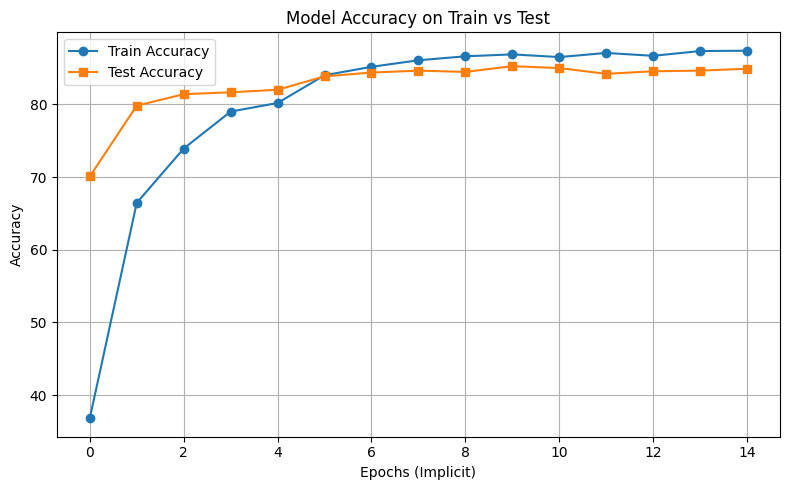

In [ ]:
plt.figure(figsize=(8, 5))
plt.plot(train_acc_history, label='Train Accuracy', marker='o')
plt.plot(test_acc_history, label='Test Accuracy', marker='s')
plt.title('Model Accuracy on Train vs Test')
plt.xlabel('Epochs (Implicit)')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

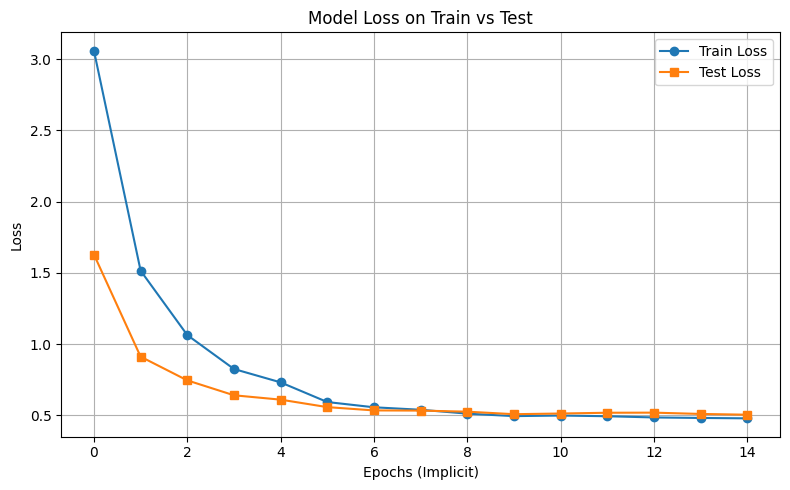

In [ ]:
plt.figure(figsize=(8, 5))
plt.plot(train_loss_history, label='Train Loss', marker='o')
plt.plot(test_loss_history, label='Test Loss', marker='s')
plt.title('Model Loss on Train vs Test')
plt.xlabel('Epochs (Implicit)')
plt.ylabel('Loss')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
# Reverse it to decode numbers back to class names
decoding_dict = {v: k for k, v in label_dict.items()}

# ✅ Set model to eval mode and collect all predictions
model.eval()
all_preds = []
all_labels = []

with torch.no_grad():
    for images, labels in tqdm(test_loader, desc="Collecting Predictions"):
        images = images.to(device)
        outputs = model(images)
        _, preds = torch.max(outputs, 1)

        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

# ✅ Convert numeric labels back to animal names
all_labels_named = [decoding_dict[label] for label in all_labels]
all_preds_named = [decoding_dict[pred] for pred in all_preds]

# ✅ Identify misclassifications
misclassifications = [
    (true, pred) for true, pred in zip(all_labels_named, all_preds_named) if true != pred
]

# ✅ Count the number of times each misclassification occurred
misclass_count = Counter(misclassifications)

# ✅ Create a DataFrame for better readability
misclass_df = pd.DataFrame([
    {"Actual Label": actual, "Predicted Label": predicted, "Count": count}
    for (actual, predicted), count in misclass_count.items()
])

# ✅ Sort the DataFrame by count (descending)
misclass_df = misclass_df.sort_values(by="Count", ascending=False).reset_index(drop=True)

# ✅ Display the table
print("\n" + misclass_df.to_string(index=False))


Actual Label Predicted Label  Count
   porcupine          lizard      6
   butterfly        ladybugs      3
    seahorse          turtle      3
    hornbill     caterpillar      3
       eagle             cow      3
  woodpecker         gorilla      3
 caterpillar             rat      3
 caterpillar          donkey      2
    mosquito           whale      2
       snake            hare      2
        crab        flamingo      2
        crab              ox      2
       horse       cockroach      2
      lizard       porcupine      2
 caterpillar        antelope      2
   butterfly           otter      1
   orangutan         pelican      1
        worm        kangaroo      1
     opossum       red panda      1
 common loon        starfish      1
     giraffe           squid      1
     dolphin         ostrich      1
         fox         lobster      1
   dragonfly         hamster      1
  rhinoceros         lobster      1
  rhinoceros           sheep      1
       eagle             ra

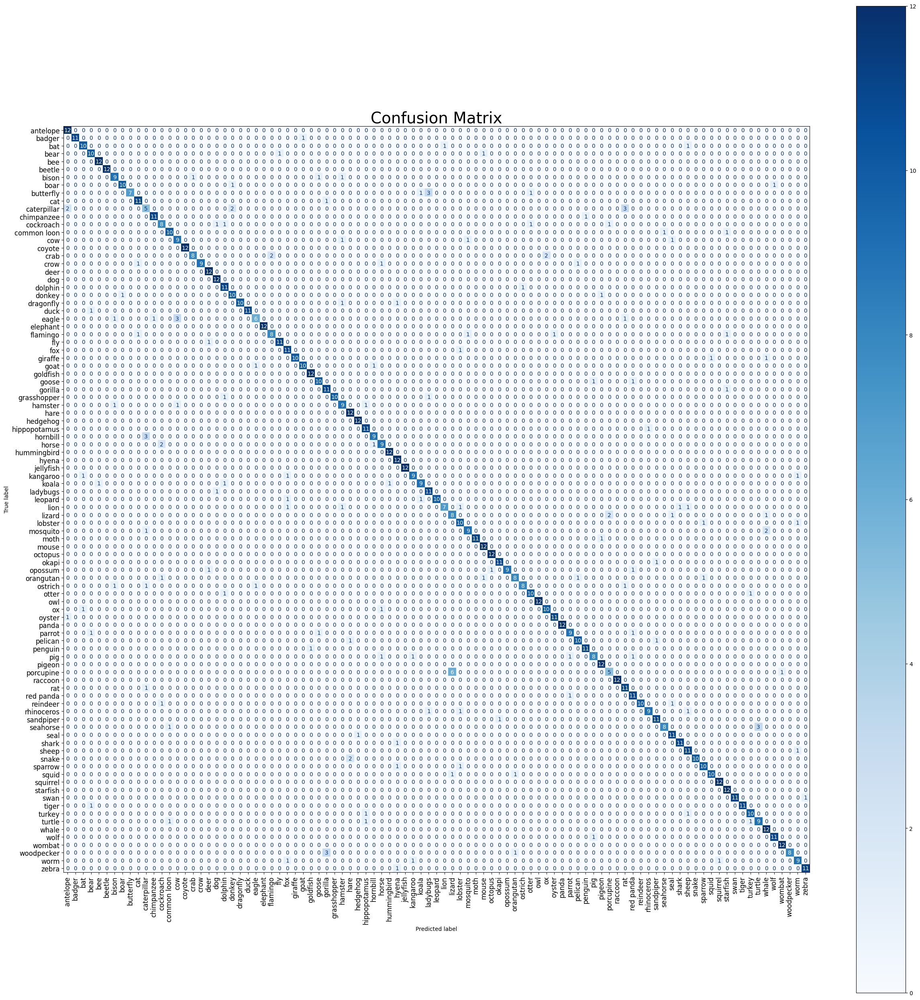

In [ ]:
# Reverse it to decode numbers back to class names
decoding_dict = {v: k for k, v in label_dict.items()}

# Set model to eval mode and collect all predictions
model.eval()
all_preds = []
all_labels = []

with torch.no_grad():
    for images, labels in tqdm(test_loader, desc="Collecting Predictions"):
        images = images.to(device)
        outputs = model(images)
        _, preds = torch.max(outputs, 1)
        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

# Convert numeric labels back to class names
all_labels_named = [decoding_dict[label] for label in all_labels]
all_preds_named = [decoding_dict[pred] for pred in all_preds]

# Create a single confusion matrix over the entire test set
cm = confusion_matrix(all_labels_named, all_preds_named, labels=list(label_dict.keys()))

# Plot it once
plt.figure(figsize=(25, 25))
ax = plt.gca()
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=list(label_dict.keys()))
disp.plot(cmap="Blues", xticks_rotation=90, ax=ax)
ax.tick_params(axis='x', labelsize=12)
ax.tick_params(axis='y', labelsize=12)
plt.title("Confusion Matrix", fontsize=28)
plt.tight_layout()
plt.show()